In [1]:
# pip install 'scvi-tools==0.17.1'

In [2]:
import os
os.environ['PATH'] += os.pathsep + '/home/jupyter/.local/bin'

In [3]:
import scvi

Global seed set to 0


In [4]:
print(scvi.__version__)

0.17.1


### brain ec integration

In [5]:
import pandas as pd
import numpy as np
import scanpy as sc #pip install scanpy
import anndata
import scipy

import sys,os
import scvi

In [6]:
import matplotlib
import seaborn as sns
from matplotlib import colors
import matplotlib.pyplot as plt
from matplotlib import rcParams
from matplotlib.pyplot import rc_context
from matplotlib.colors import LinearSegmentedColormap
from statsmodels.stats.multitest import multipletests

sc.logging.print_header()
sc.settings.verbosity = 3
sc.settings.set_figure_params(dpi=100, facecolor='white')

scanpy==1.9.6 anndata==0.9.2 umap==0.5.4 numpy==1.24.4 scipy==1.10.1 pandas==2.0.3 scikit-learn==1.3.2 statsmodels==0.14.0 igraph==0.11.2 pynndescent==0.5.10


In [8]:
pwd

'/home/jupyter/tmpmount/vasculature/nuclei/nuclei_datasets/whole_nuclei_objects'

In [8]:
# Directory containing the .h5ad files
directory = '/home/jupyter/tmpmount/vasculature/nuclei/nuclei_datasets/whole_nuclei_objects/'

# List to store all loaded adata objects
adata_list = []

# Loop through all files in the directory
for filename in os.listdir(directory):
    if filename.endswith('nuclei.h5ad'):
        filepath = os.path.join(directory, filename)
        
        # Read the .h5ad file using scanpy
        adata = sc.read_h5ad(filepath)
        print(filename)
        print(adata.X[:5, :5])

lung_all_nuclei.h5ad

Garcia_all_nuclei.h5ad

pancreas_all_nuclei.h5ad

skeletal_muscle_all_nuclei.h5ad

liver_all_nuclei.h5ad
  (1, 3)	1.0
  (2, 2)	1.0
  (2, 3)	1.0
  (3, 0)	1.0
  (3, 3)	1.0
  (3, 4)	1.0
  (4, 4)	1.0
heart_all_nuclei.h5ad

Yang_et_al_healthy_raw_nuclei.h5ad

kidney_all_nuclei.h5ad
  (4, 3)	1.0
Sun_et_al_healthy_raw_nuclei.h5ad
[[0 0 0 0 1]
 [0 0 0 0 0]
 [0 0 0 0 1]
 [0 0 0 0 0]
 [0 0 0 0 1]]


In [9]:
# Directory containing the .h5ad files
directory = '/home/jupyter/tmpmount/vasculature/nuclei/nuclei_datasets/whole_nuclei_objects/'

# List to store all loaded adata objects
adata_list = []

# Loop through all files in the directory
for filename in os.listdir(directory):
    filepath = os.path.join(directory, filename)
    
    # Check if the file is a H5AD file
    if filename.endswith('nuclei.h5ad') and os.path.isfile(filepath):
        # Read the .h5ad file using scanpy
        adata = sc.read_h5ad(filepath)
        adata.var['mt'] = adata.var_names.str.startswith('MT-')  # annotate the group of mitochondrial genes as 'mt'
        sc.pp.calculate_qc_metrics(adata, qc_vars=['mt'], percent_top=None, log1p=False, inplace=True)
        adata.var['rb'] = adata.var_names.str.startswith('RPS', 'RPL')  # annotate the group of ribosomal genes as 'ribo'
        sc.pp.calculate_qc_metrics(adata, qc_vars=['rb'], percent_top=None, log1p=False, inplace=True)
        if 'Dataset' in adata.obs:
        # Replace the name with 'study'
            adata.obs['study'] = adata.obs['Dataset']
        
        # Append the loaded adata to the list
        adata_list.append(adata)

# Concatenate all loaded adata objects
adata = adata.concatenate(adata_list, join='inner', batch_key=None, index_unique=None)


/opt/conda/envs/scvi/lib/python3.8/site-packages/anndata/_core/anndata.py:1763: FutureWarning: The AnnData.concatenate method is deprecated in favour of the anndata.concat function. Please use anndata.concat instead.

See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  warnings.warn(
/opt/conda/envs/scvi/lib/python3.8/site-packages/anndata/_core/merge.py:1111: UserWarning: Only some AnnData objects have `.raw` attribute, not concatenating `.raw` attributes.
  warn(
/opt/conda/envs/scvi/lib/python3.8/site-packages/anndata/_core/anndata.py:1838: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/opt/conda/envs/scvi/lib/python3.8/site-packages/anndata/_core/anndata.py:1838: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


In [10]:
adata

AnnData object with n_obs × n_vars = 976085 × 14675
    obs: 'subject', 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'id', 'library_id', 'batch', 'brain_region', 'age_death', 'msex', 'pmi', 'ADdiag2types', 'percent.mt', 'percent.rp', 'celltype', 'cellsubtype', 'donor', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_rb', 'pct_counts_rb', 'kit', 'study', 'organ', 'cell_or_nuclei', 'ID', 'Study', 'PoolDon', 'DonorPool', 'scDonor_snBatch', 'lung_cell_states', 'cell_state', 'lung_region', 'sample', 'sex', 'suspension_type', 'SampleID', 'PatientID', 'snRNAPreparation', 'RNA_snn_res.0.5', 'seurat_clusters', 'oricluster', 'newcluster', 'Dataset', 'development_stage', 'pancreas_cell_states', 'cell_type', 'skeletal_muscle_cell_states', 'suspension_uuid', 'liver_cell_states', 'liver_region', 'age_group', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'scrublet_score', 'heart_cell_states', 'heart_region', 'Cell', 'Treat', 'Sample', 'Region', 'nCount_S

In [11]:
import scipy.sparse as sp
adata.X = sp.csr_matrix(adata.X)

In [12]:
adata.obs.study.value_counts()

study
Litvinukova_et_al_2020    359652
Perez et al. 2022         143051
Lake et al. 2021           85194
Garcia_et_al_2022          84350
Tosti et al. 2021          79367
Yang_et_al_2022            72371
Madissoon_et_al_2022       63768
MacParland_et_al_2018      43863
Sun_et_al_2023             24484
Muto et al. 2021           19985
Name: count, dtype: int64

In [13]:
adata.obs.organ.value_counts()

organ
Heart              359652
brain              181205
Skeletal_muscle    143051
Kidney             105179
Pancreas            79367
Lung                63768
Liver               43863
Name: count, dtype: int64

In [14]:
pd.crosstab(adata.obs.study, adata.obs.organ)

organ,Heart,Kidney,Liver,Lung,Pancreas,Skeletal_muscle,brain
study,,,,,,,
Garcia_et_al_2022,0,0,0,0,0,0,84350
Lake et al. 2021,0,85194,0,0,0,0,0
Litvinukova_et_al_2020,359652,0,0,0,0,0,0
MacParland_et_al_2018,0,0,43863,0,0,0,0
Madissoon_et_al_2022,0,0,0,63768,0,0,0
Muto et al. 2021,0,19985,0,0,0,0,0
Perez et al. 2022,0,0,0,0,0,143051,0
Sun_et_al_2023,0,0,0,0,0,0,24484
Tosti et al. 2021,0,0,0,0,79367,0,0


In [15]:
# Copy adata.X counts to adata.layers['counts']
adata.layers['counts'] = adata.X.copy()

In [16]:
adata.obs.kit

SM_171013Tsa.CTACCCAGTGCAACGA-3     10x3prime_v3
SM_171013Tsa.AACTTTCTCTGCAGTA-7     10x3prime_v3
SM_171013Tsa.AGATTGCGTGCAGTAG-7     10x3prime_v3
SM_171013Tsa.CGCGGTACACGCATCG-13    10x3prime_v3
SM_171013Tsa.CTCTAATAGAAACCAT-15    10x3prime_v3
                                        ...     
Thalamus.TGATTTCAGCGATGCA-47        10x3prime_v3
Thalamus.TGCTCGTCAGGTTCGC-47        10x3prime_v3
Thalamus.TTACAGGCACACCTGG-47        10x3prime_v3
Thalamus.TTCCGGTCACCGTACG-47        10x3prime_v3
Thalamus.TTGAACGCACAGTCAT-47        10x3prime_v3
Name: kit, Length: 976085, dtype: category
Categories (7, object): ['10x3prime_v3', '10x 3' v2', '10x 3' v3', '10x 5' v1', 'V2', 'V3', 'nan']

In [17]:
pd.crosstab(adata.obs['study'], adata.obs['kit'])

kit,10x3prime_v3,10x 3' v2,10x 3' v3,10x 5' v1,V2,V3,nan
study,,,,,,,
Garcia_et_al_2022,84350,0,0,0,0,0,0
Lake et al. 2021,0,0,85194,0,0,0,0
Litvinukova_et_al_2020,0,0,0,0,168244,191408,0
MacParland_et_al_2018,0,0,43863,0,0,0,0
Madissoon_et_al_2022,0,0,0,0,0,0,63768
Muto et al. 2021,0,0,0,19985,0,0,0
Perez et al. 2022,0,0,0,143051,0,0,0
Sun_et_al_2023,24484,0,0,0,0,0,0
Tosti et al. 2021,0,79367,0,0,0,0,0


In [18]:
# Replace 'nan' values under adata.obs.kit with the string 'v3'
adata.obs['kit'] = adata.obs['kit'].replace('nan', "10x 3' v3")

In [19]:
# Replace 'nan' values under adata.obs.kit with the string 'v3'
adata.obs['kit'] = adata.obs['kit'].replace('V2', "10x 3' v2")
adata.obs['kit'] = adata.obs['kit'].replace('V3', "10x 3' v3")

In [20]:
adata

AnnData object with n_obs × n_vars = 976085 × 14675
    obs: 'subject', 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'id', 'library_id', 'batch', 'brain_region', 'age_death', 'msex', 'pmi', 'ADdiag2types', 'percent.mt', 'percent.rp', 'celltype', 'cellsubtype', 'donor', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_rb', 'pct_counts_rb', 'kit', 'study', 'organ', 'cell_or_nuclei', 'ID', 'Study', 'PoolDon', 'DonorPool', 'scDonor_snBatch', 'lung_cell_states', 'cell_state', 'lung_region', 'sample', 'sex', 'suspension_type', 'SampleID', 'PatientID', 'snRNAPreparation', 'RNA_snn_res.0.5', 'seurat_clusters', 'oricluster', 'newcluster', 'Dataset', 'development_stage', 'pancreas_cell_states', 'cell_type', 'skeletal_muscle_cell_states', 'suspension_uuid', 'liver_cell_states', 'liver_region', 'age_group', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'scrublet_score', 'heart_cell_states', 'heart_region', 'Cell', 'Treat', 'Sample', 'Region', 'nCount_S

In [21]:
#adata.var['mt'] = adata.var_names.str.startswith('MT-')  # annotate the group of mitochondrial genes as 'mt'
#sc.pp.calculate_qc_metrics(adata, qc_vars=['mt'], percent_top=None, log1p=False, inplace=True)

In [22]:
#adata.var['rb'] = adata.var_names.str.startswith('RPS')  # annotate the group of ribosomal genes as 'ribo'
#sc.pp.calculate_qc_metrics(adata, qc_vars=['rb'], percent_top=None, log1p=False, inplace=True)

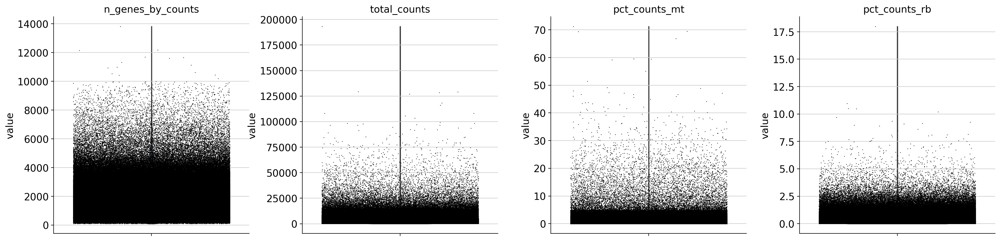

In [23]:
sc.pl.violin(adata, ['n_genes_by_counts', 'total_counts', 'pct_counts_mt','pct_counts_rb'],
             jitter=0.4, multi_panel=True)

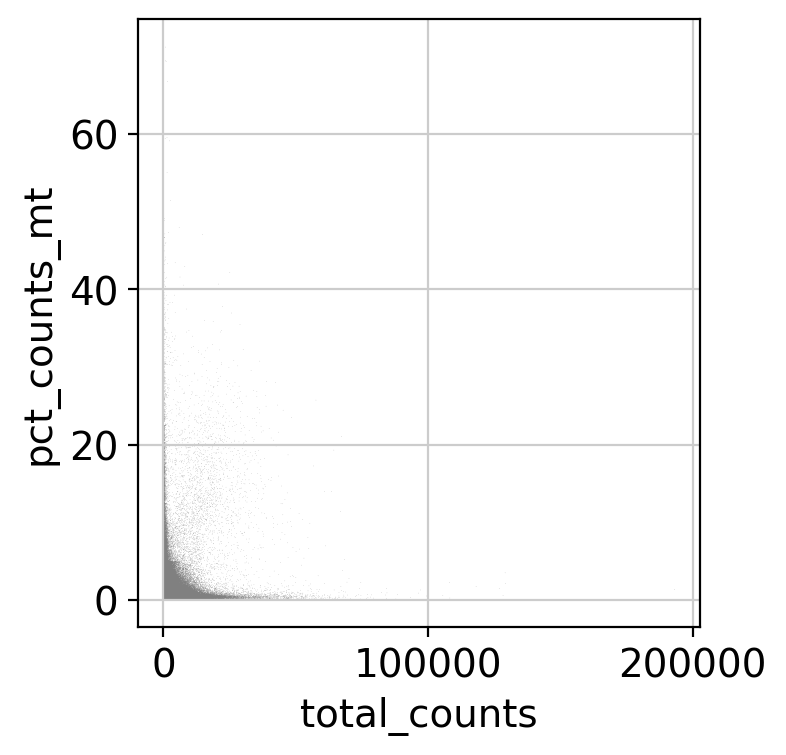

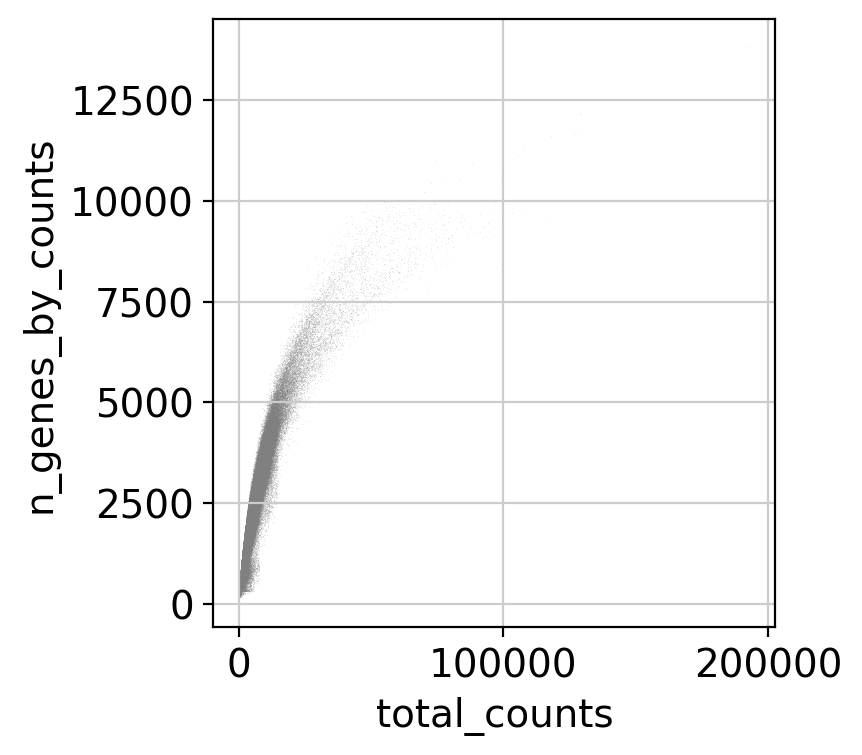

In [24]:
sc.pl.scatter(adata, x='total_counts', y='pct_counts_mt')
sc.pl.scatter(adata, x='total_counts', y='n_genes_by_counts')

In [25]:
adata = adata[adata.obs.pct_counts_mt < 40, :]

In [26]:
adata

View of AnnData object with n_obs × n_vars = 976044 × 14675
    obs: 'subject', 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'id', 'library_id', 'batch', 'brain_region', 'age_death', 'msex', 'pmi', 'ADdiag2types', 'percent.mt', 'percent.rp', 'celltype', 'cellsubtype', 'donor', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_rb', 'pct_counts_rb', 'kit', 'study', 'organ', 'cell_or_nuclei', 'ID', 'Study', 'PoolDon', 'DonorPool', 'scDonor_snBatch', 'lung_cell_states', 'cell_state', 'lung_region', 'sample', 'sex', 'suspension_type', 'SampleID', 'PatientID', 'snRNAPreparation', 'RNA_snn_res.0.5', 'seurat_clusters', 'oricluster', 'newcluster', 'Dataset', 'development_stage', 'pancreas_cell_states', 'cell_type', 'skeletal_muscle_cell_states', 'suspension_uuid', 'liver_cell_states', 'liver_region', 'age_group', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'scrublet_score', 'heart_cell_states', 'heart_region', 'Cell', 'Treat', 'Sample', 'Region', '

In [27]:
np.unique(adata.obs['donor'].astype(str))

array(['18-142', '18-162', '18-312', '3499', '3504', '3535', '3593',
       '3613', 'A26', 'A37', 'A40', 'A41', 'A42', 'A47', 'A48', 'AFES365',
       'AFES448', 'C1', 'C2', 'C3', 'C4', 'C41', 'C5', 'C58', 'C7', 'C70',
       'C72', 'C8', 'C9', 'D1', 'D11', 'D2', 'D3', 'D4', 'D5', 'D6', 'D7',
       'E181', 'E212', 'E213', 'E219', 'E232', 'E268', 'E290', 'E311',
       'E337', 'E361', 'E371', 'E372', 'E379', 'E381', 'H2', 'H3', 'H4',
       'H5', 'H6', 'H7', 'HM1', 'HM10', 'HM11', 'HM12', 'HM13', 'HM15',
       'HM2', 'HM21', 'HM22', 'HM23', 'HM3', 'HM4', 'HM5', 'HM6', 'HM7',
       'HM8', 'HM9', 'KRP446', 'KRP460', 'KRP461', 'KRP462', 'L425_17',
       'L425_23', 'L425_25', 'L425_27', 'L425_33', 'ROSMAP-10643',
       'ROSMAP-12311', 'ROSMAP-12562', 'ROSMAP-13327', 'ROSMAP-13381',
       'ROSMAP-13759', 'ROSMAP-13862', 'ROSMAP-14312', 'ROSMAP-14332',
       'ROSMAP-14748', 'ROSMAP-14875', 'ROSMAP-15253', 'ROSMAP-15389',
       'ROSMAP-16518', 'ROSMAP-16562', 'ROSMAP-17975', 'ROSMAP-18

In [28]:
adata.obs['donor'] = adata.obs['donor'].astype(str)

/var/tmp/ipykernel_135331/3555885290.py:1: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['donor'] = adata.obs['donor'].astype(str)
/opt/conda/envs/scvi/lib/python3.8/site-packages/anndata/_core/anndata.py:1838: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


In [29]:
adata.obs['donor'].value_counts()

donor
D2              43143
H5              38401
AFES448         34167
H3              32458
H7              32336
                ...  
ROSMAP-45804        2
ROSMAP-93570        2
ROSMAP-62351        2
ROSMAP-92734        2
ROSMAP-15389        2
Name: count, Length: 305, dtype: int64

In [30]:
adata

AnnData object with n_obs × n_vars = 976044 × 14675
    obs: 'subject', 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'id', 'library_id', 'batch', 'brain_region', 'age_death', 'msex', 'pmi', 'ADdiag2types', 'percent.mt', 'percent.rp', 'celltype', 'cellsubtype', 'donor', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_rb', 'pct_counts_rb', 'kit', 'study', 'organ', 'cell_or_nuclei', 'ID', 'Study', 'PoolDon', 'DonorPool', 'scDonor_snBatch', 'lung_cell_states', 'cell_state', 'lung_region', 'sample', 'sex', 'suspension_type', 'SampleID', 'PatientID', 'snRNAPreparation', 'RNA_snn_res.0.5', 'seurat_clusters', 'oricluster', 'newcluster', 'Dataset', 'development_stage', 'pancreas_cell_states', 'cell_type', 'skeletal_muscle_cell_states', 'suspension_uuid', 'liver_cell_states', 'liver_region', 'age_group', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'scrublet_score', 'heart_cell_states', 'heart_region', 'Cell', 'Treat', 'Sample', 'Region', 'nCount_S

In [31]:
adata.layers['counts'][1:10, 1:10].toarray()

array([[0., 0., 0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 1., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 1., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 1., 0., 1., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0., 0., 2.],
       [0., 0., 0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 5., 1., 0., 0., 1., 0.]])

In [32]:
adata.X[1:10, 1:10].toarray()

array([[0., 0., 0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 1., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 1., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 1., 0., 1., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0., 0., 2.],
       [0., 0., 0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 5., 1., 0., 0., 1., 0.]])

In [33]:
# run scrublet
import scrublet

In [34]:
adata.obs_names_make_unique()

In [35]:
sc.external.pp.scrublet(adata, batch_key='study')

Running Scrublet


/opt/conda/envs/scvi/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:250: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  adata.var['n_cells'] = number


normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:04)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


/opt/conda/envs/scvi/lib/python3.8/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:01)
Embedding transcriptomes using PCA...
Automatically set threshold at doublet score = 0.67
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 15.3%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 0.2%
filtered out 43 genes that are detected in less than 3 cells


/opt/conda/envs/scvi/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:250: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  adata.var['n_cells'] = number


normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:04)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


/opt/conda/envs/scvi/lib/python3.8/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:01)
Embedding transcriptomes using PCA...
Automatically set threshold at doublet score = 0.77
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 5.0%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 0.1%
filtered out 14 genes that are detected in less than 3 cells


/opt/conda/envs/scvi/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:250: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  adata.var['n_cells'] = number


normalizing counts per cell
    finished (0:00:02)
extracting highly variable genes
    finished (0:00:10)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


/opt/conda/envs/scvi/lib/python3.8/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:02)
Embedding transcriptomes using PCA...
Automatically set threshold at doublet score = 0.39
Detected doublet rate = 1.1%
Estimated detectable doublet fraction = 44.9%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 2.4%
filtered out 62 genes that are detected in less than 3 cells


/opt/conda/envs/scvi/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:250: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  adata.var['n_cells'] = number


normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:03)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


/opt/conda/envs/scvi/lib/python3.8/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
Automatically set threshold at doublet score = 0.76
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 4.3%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 0.2%
filtered out 23 genes that are detected in less than 3 cells


/opt/conda/envs/scvi/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:250: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  adata.var['n_cells'] = number


normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:02)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


/opt/conda/envs/scvi/lib/python3.8/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
Automatically set threshold at doublet score = 0.59
Detected doublet rate = 0.1%
Estimated detectable doublet fraction = 21.5%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 0.6%
filtered out 191 genes that are detected in less than 3 cells


/opt/conda/envs/scvi/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:250: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  adata.var['n_cells'] = number


normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:01)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


/opt/conda/envs/scvi/lib/python3.8/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
Automatically set threshold at doublet score = 0.69
Detected doublet rate = 0.1%
Estimated detectable doublet fraction = 7.2%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 0.7%
filtered out 832 genes that are detected in less than 3 cells


/opt/conda/envs/scvi/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:250: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  adata.var['n_cells'] = number


normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:03)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


/opt/conda/envs/scvi/lib/python3.8/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
Automatically set threshold at doublet score = 0.20
Detected doublet rate = 7.9%
Estimated detectable doublet fraction = 47.7%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 16.5%


/opt/conda/envs/scvi/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:250: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  adata.var['n_cells'] = number


normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:01)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


/opt/conda/envs/scvi/lib/python3.8/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
Automatically set threshold at doublet score = 0.58
Detected doublet rate = 0.1%
Estimated detectable doublet fraction = 31.4%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 0.2%
filtered out 757 genes that are detected in less than 3 cells


/opt/conda/envs/scvi/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:250: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  adata.var['n_cells'] = number


normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:01)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


/opt/conda/envs/scvi/lib/python3.8/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
Automatically set threshold at doublet score = 0.82
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 0.2%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 0.5%
filtered out 105 genes that are detected in less than 3 cells


/opt/conda/envs/scvi/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:250: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  adata.var['n_cells'] = number


normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:01)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


/opt/conda/envs/scvi/lib/python3.8/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
Automatically set threshold at doublet score = 0.38
Detected doublet rate = 1.3%
Estimated detectable doublet fraction = 42.4%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 3.0%
    Scrublet finished (0:57:34)


In [36]:
adata.obs['predicted_doublet'] = adata.obs['predicted_doublet'].astype('str')

In [37]:
adata

AnnData object with n_obs × n_vars = 976044 × 14675
    obs: 'subject', 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'id', 'library_id', 'batch', 'brain_region', 'age_death', 'msex', 'pmi', 'ADdiag2types', 'percent.mt', 'percent.rp', 'celltype', 'cellsubtype', 'donor', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_rb', 'pct_counts_rb', 'kit', 'study', 'organ', 'cell_or_nuclei', 'ID', 'Study', 'PoolDon', 'DonorPool', 'scDonor_snBatch', 'lung_cell_states', 'cell_state', 'lung_region', 'sample', 'sex', 'suspension_type', 'SampleID', 'PatientID', 'snRNAPreparation', 'RNA_snn_res.0.5', 'seurat_clusters', 'oricluster', 'newcluster', 'Dataset', 'development_stage', 'pancreas_cell_states', 'cell_type', 'skeletal_muscle_cell_states', 'suspension_uuid', 'liver_cell_states', 'liver_region', 'age_group', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'scrublet_score', 'heart_cell_states', 'heart_region', 'Cell', 'Treat', 'Sample', 'Region', 'nCount_S

In [38]:
# normalise and log-transform
sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)
adata.X[1:10, 1:10].toarray()

normalizing counts per cell
    finished (0:00:07)


array([[0.        , 0.        , 0.        , 0.        , 0.        ,
        0.        , 0.        , 0.        , 0.        ],
       [0.        , 0.        , 0.        , 1.82983568, 0.        ,
        0.        , 0.        , 0.        , 0.        ],
       [0.        , 0.        , 0.        , 0.        , 0.        ,
        0.        , 0.        , 0.        , 0.        ],
       [0.        , 0.        , 0.        , 2.50541115, 0.        ,
        0.        , 0.        , 0.        , 0.        ],
       [0.        , 0.        , 0.        , 0.        , 0.        ,
        0.        , 0.        , 0.        , 0.        ],
       [0.        , 0.        , 0.        , 2.28742653, 0.        ,
        2.28742653, 0.        , 0.        , 0.        ],
       [0.        , 0.        , 0.        , 0.        , 0.        ,
        0.        , 0.        , 0.        , 2.96436301],
       [0.        , 0.        , 0.        , 0.        , 0.        ,
        0.        , 0.        , 0.        , 0.        ],


In [39]:
sc.pp.highly_variable_genes(
    adata,
    flavor="seurat_v3",
    n_top_genes=5000,
    layer="counts",
    subset = False, 
    batch_key="study")

If you pass `n_top_genes`, all cutoffs are ignored.
extracting highly variable genes
--> added
    'highly_variable', boolean vector (adata.var)
    'highly_variable_rank', float vector (adata.var)
    'means', float vector (adata.var)
    'variances', float vector (adata.var)
    'variances_norm', float vector (adata.var)


In [40]:
adata.write('/home/jupyter/tmpmount/vasculature/nuclei/nuclei_datasets/whole_nuclei_objects/all_org_nuclei_log1p.h5ad')

In [7]:
adata = sc.read_h5ad('/home/jupyter/tmpmount/vasculature/nuclei/nuclei_datasets/whole_nuclei_objects/all_org_nuclei_log1p.h5ad')

In [8]:
adata

AnnData object with n_obs × n_vars = 976044 × 5000
    obs: 'subject', 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'id', 'library_id', 'batch', 'brain_region', 'age_death', 'msex', 'pmi', 'ADdiag2types', 'percent.mt', 'percent.rp', 'celltype', 'cellsubtype', 'donor', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_rb', 'pct_counts_rb', 'kit', 'study', 'organ', 'cell_or_nuclei', 'ID', 'Study', 'PoolDon', 'DonorPool', 'scDonor_snBatch', 'lung_cell_states', 'cell_state', 'lung_region', 'sample', 'sex', 'suspension_type', 'SampleID', 'PatientID', 'snRNAPreparation', 'RNA_snn_res.0.5', 'seurat_clusters', 'oricluster', 'newcluster', 'Dataset', 'development_stage', 'pancreas_cell_states', 'cell_type', 'skeletal_muscle_cell_states', 'suspension_uuid', 'liver_cell_states', 'liver_region', 'age_group', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'scrublet_score', 'heart_cell_states', 'heart_region', 'Cell', 'Treat', 'Sample', 'Region', 'nCount_SC

In [9]:
adata.obs.kit

SM_171013Tsa.CTACCCAGTGCAACGA-3     10x3prime_v3
SM_171013Tsa.AACTTTCTCTGCAGTA-7     10x3prime_v3
SM_171013Tsa.AGATTGCGTGCAGTAG-7     10x3prime_v3
SM_171013Tsa.CGCGGTACACGCATCG-13    10x3prime_v3
SM_171013Tsa.CTCTAATAGAAACCAT-15    10x3prime_v3
                                        ...     
Thalamus.TGATTTCAGCGATGCA-47-1      10x3prime_v3
Thalamus.TGCTCGTCAGGTTCGC-47-1      10x3prime_v3
Thalamus.TTACAGGCACACCTGG-47-1      10x3prime_v3
Thalamus.TTCCGGTCACCGTACG-47-1      10x3prime_v3
Thalamus.TTGAACGCACAGTCAT-47-1      10x3prime_v3
Name: kit, Length: 976044, dtype: category
Categories (4, object): ['10x3prime_v3', '10x 3' v2', '10x 3' v3', '10x 5' v1']

In [10]:
pd.crosstab(adata.obs.kit, adata.obs.organ)

organ,Heart,Kidney,Liver,Lung,Pancreas,Skeletal_muscle,brain
kit,,,,,,,
10x3prime_v3,0,0,0,0,0,0,181205
10x 3' v2,168244,0,0,0,79367,0,0
10x 3' v3,191408,85194,43833,63768,0,0,0
10x 5' v1,0,19985,0,0,0,143040,0


In [11]:
import pandas as pd

# Assuming adata.obs.kit is a DataFrame
# Let's say you want to change the category "old_category" to "new_category"
adata.obs['kit'] = adata.obs['kit'].replace("10x3prime_v3", "10x 3' v3")

In [12]:
pd.crosstab(adata.obs.kit, adata.obs.organ)

organ,Heart,Kidney,Liver,Lung,Pancreas,Skeletal_muscle,brain
kit,,,,,,,
10x 3' v2,168244,0,0,0,79367,0,0
10x 3' v3,191408,85194,43833,63768,0,0,181205
10x 5' v1,0,19985,0,0,0,143040,0


In [14]:
pd.crosstab(adata.obs.organ, adata.obs.total_counts)

total_counts,111.0,112.0,113.0,114.0,115.0,116.0,117.0,118.0,119.0,120.0,...,105591.0,108177.0,108242.0,116104.0,118153.0,126890.0,128340.0,129116.0,129330.0,193179.0
organ,,,,,,,,,,,,,,,,,,,,,
Heart,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
Kidney,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
Liver,1,1,4,9,4,3,5,5,4,4,...,1,1,0,0,1,1,1,1,1,1
Lung,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
Pancreas,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
Skeletal_muscle,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
brain,0,0,0,0,0,0,0,0,0,0,...,0,0,1,1,0,0,0,0,0,0


In [15]:
pd.crosstab(adata.obs.organ, adata.obs.n_genes_by_counts)

n_genes_by_counts,101,102,103,104,105,106,107,108,109,110,...,10931,10983,11125,11313,11608,11649,11696,12145,12179,13819
organ,,,,,,,,,,,,,,,,,,,,,
Heart,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
Kidney,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
Liver,2,9,6,6,16,14,9,14,13,20,...,1,1,1,1,1,1,1,1,1,1
Lung,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
Pancreas,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
Skeletal_muscle,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
brain,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [16]:
scvi.model.SCVI.setup_anndata(
    adata, 
    layer="counts", 
    batch_key="donor", 
    categorical_covariate_keys=['kit'], 
    continuous_covariate_keys=['total_counts', 'n_genes_by_counts','pct_counts_mt', 'pct_counts_rb'])

No GPU/TPU found, falling back to CPU. (Set TF_CPP_MIN_LOG_LEVEL=0 and rerun for more info.)
/opt/conda/envs/scvi/lib/python3.8/site-packages/scvi/data/_utils.py:168: UserWarning: Category 95 in adata.obs['_scvi_batch'] has fewer than 3 cells. Models may not train properly.
  warnings.warn(


In [17]:
vae = scvi.model.SCVI(adata, n_layers=2, n_latent=30)
#scvi.data.view_anndata_setup(adata)
vae
vae.train()
adata.obsm["X_scVI"] = vae.get_latent_representation()
adata.X.shape
sc.pp.neighbors(adata, use_rep="X_scVI")

/opt/conda/envs/scvi/lib/python3.8/site-packages/scvi/model/base/_training_mixin.py:67: UserWarning: max_epochs=8 is less than n_epochs_kl_warmup=400. The max_kl_weight will not be reached during training.
  warnings.warn(
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Epoch 8/8: 100%|██████████| 8/8 [11:42<00:00, 87.86s/it, loss=1.43e+03, v_num=1]
computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:02:19)


In [18]:
sc.tl.umap(adata)

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:17:26)


In [19]:
adata

AnnData object with n_obs × n_vars = 976044 × 5000
    obs: 'subject', 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'id', 'library_id', 'batch', 'brain_region', 'age_death', 'msex', 'pmi', 'ADdiag2types', 'percent.mt', 'percent.rp', 'celltype', 'cellsubtype', 'donor', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_rb', 'pct_counts_rb', 'kit', 'study', 'organ', 'cell_or_nuclei', 'ID', 'Study', 'PoolDon', 'DonorPool', 'scDonor_snBatch', 'lung_cell_states', 'cell_state', 'lung_region', 'sample', 'sex', 'suspension_type', 'SampleID', 'PatientID', 'snRNAPreparation', 'RNA_snn_res.0.5', 'seurat_clusters', 'oricluster', 'newcluster', 'Dataset', 'development_stage', 'pancreas_cell_states', 'cell_type', 'skeletal_muscle_cell_states', 'suspension_uuid', 'liver_cell_states', 'liver_region', 'age_group', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'scrublet_score', 'heart_cell_states', 'heart_region', 'Cell', 'Treat', 'Sample', 'Region', 'nCount_SC

/opt/conda/envs/scvi/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/opt/conda/envs/scvi/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/opt/conda/envs/scvi/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


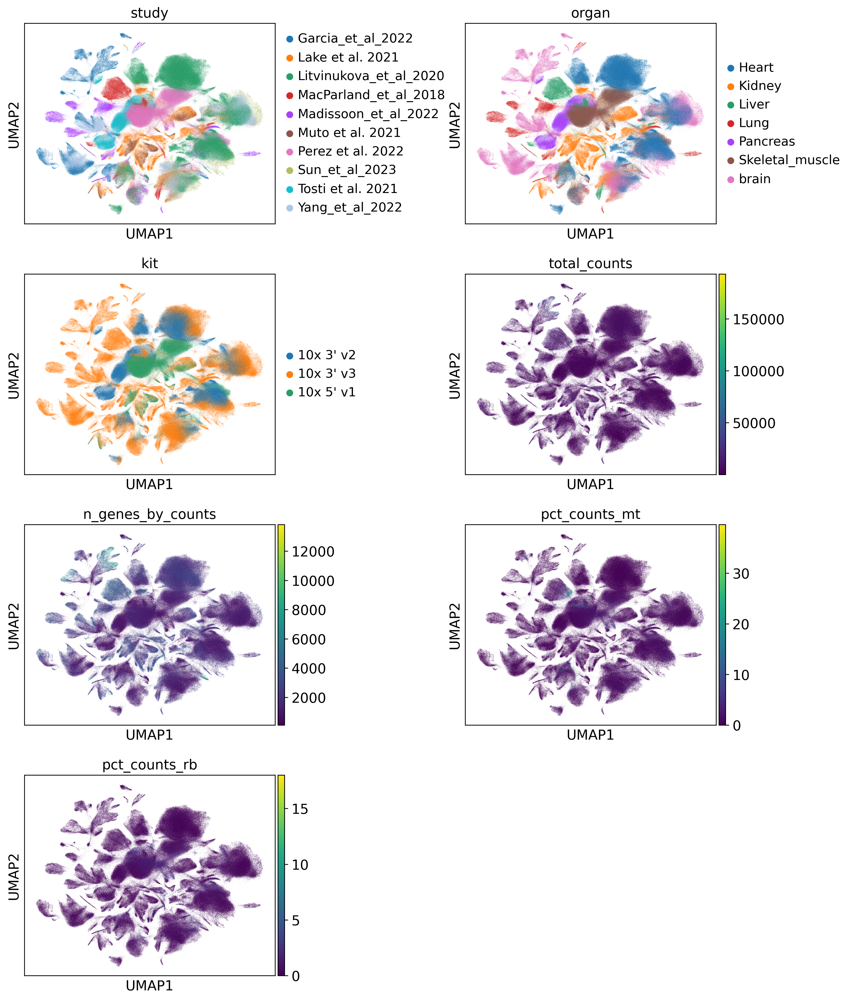

In [20]:
sc.settings.set_figure_params(dpi=150, facecolor='white')
sc.pl.umap(adata, color = ['study', 'organ',  'kit', 'total_counts', 'n_genes_by_counts','pct_counts_mt', 'pct_counts_rb'], wspace = 0.6, ncols = 2)

/opt/conda/envs/scvi/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/opt/conda/envs/scvi/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/opt/conda/envs/scvi/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


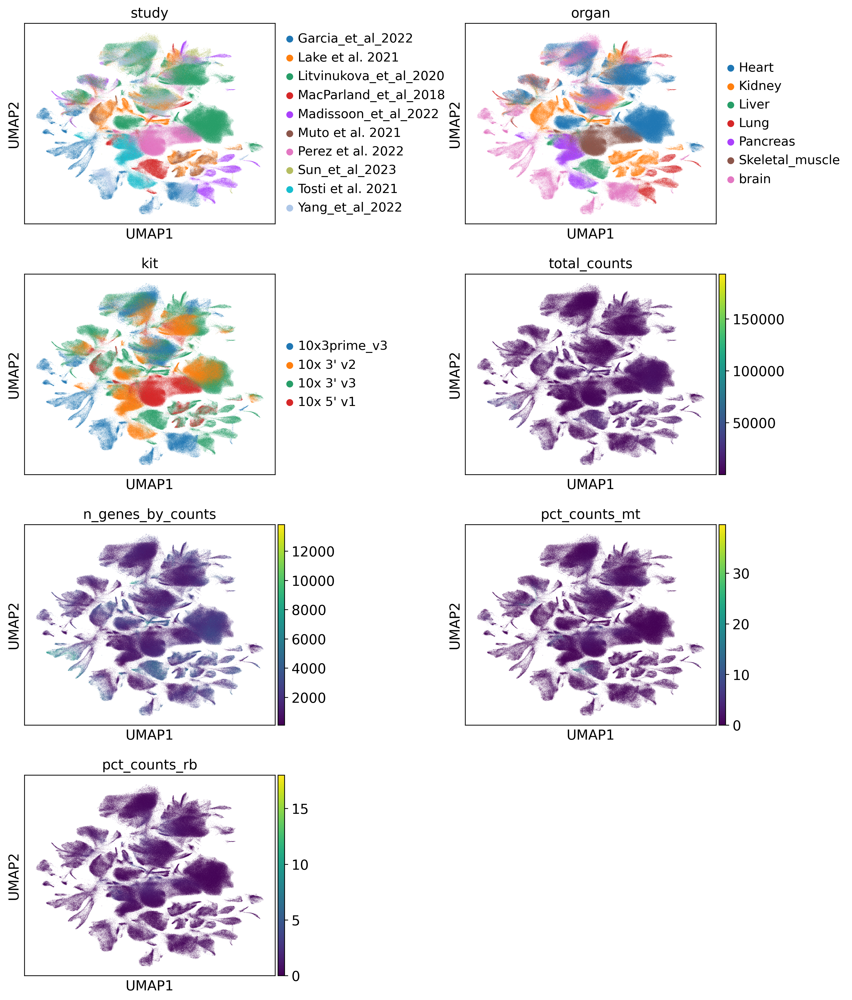

In [17]:
sc.settings.set_figure_params(dpi=150, facecolor='white')
sc.pl.umap(adata, color = ['study', 'organ',  'kit', 'total_counts', 'n_genes_by_counts','pct_counts_mt', 'pct_counts_rb'], wspace = 0.6, ncols = 2)

In [ ]:
sc.pl.umap(adata, color = ['PECAM1', 'CDH5', 'ACTA2', 'MYH11', 'DCN', 'PDGFRA', 'EPCAM', 'C1QA'], size = 10)

In [26]:
adata.write('/home/jupyter/tmpmount/vasculature/nuclei/nuclei_datasets/whole_nuclei_objects/all_org_nuclei_log1p_scvi.h5ad')

In [27]:
adata

AnnData object with n_obs × n_vars = 976044 × 5000
    obs: 'subject', 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'id', 'library_id', 'batch', 'brain_region', 'age_death', 'msex', 'pmi', 'ADdiag2types', 'percent.mt', 'percent.rp', 'celltype', 'cellsubtype', 'donor', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_rb', 'pct_counts_rb', 'kit', 'study', 'organ', 'cell_or_nuclei', 'ID', 'Study', 'PoolDon', 'DonorPool', 'scDonor_snBatch', 'lung_cell_states', 'cell_state', 'lung_region', 'sample', 'sex', 'suspension_type', 'SampleID', 'PatientID', 'snRNAPreparation', 'RNA_snn_res.0.5', 'seurat_clusters', 'oricluster', 'newcluster', 'Dataset', 'development_stage', 'pancreas_cell_states', 'cell_type', 'skeletal_muscle_cell_states', 'suspension_uuid', 'liver_cell_states', 'liver_region', 'age_group', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'scrublet_score', 'heart_cell_states', 'heart_region', 'Cell', 'Treat', 'Sample', 'Region', 'nCount_SC

# n_latent = 3

In [7]:
adata = sc.read_h5ad('/home/jupyter/tmpmount/vasculature/nuclei/nuclei_datasets/whole_nuclei_objects/all_org_nuclei_log1p.h5ad')

In [8]:
adata

AnnData object with n_obs × n_vars = 976044 × 14675
    obs: 'subject', 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'id', 'library_id', 'batch', 'brain_region', 'age_death', 'msex', 'pmi', 'ADdiag2types', 'percent.mt', 'percent.rp', 'celltype', 'cellsubtype', 'donor', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_rb', 'pct_counts_rb', 'kit', 'study', 'organ', 'cell_or_nuclei', 'ID', 'Study', 'PoolDon', 'DonorPool', 'scDonor_snBatch', 'lung_cell_states', 'cell_state', 'lung_region', 'sample', 'sex', 'suspension_type', 'SampleID', 'PatientID', 'snRNAPreparation', 'RNA_snn_res.0.5', 'seurat_clusters', 'oricluster', 'newcluster', 'Dataset', 'development_stage', 'pancreas_cell_states', 'cell_type', 'skeletal_muscle_cell_states', 'suspension_uuid', 'liver_cell_states', 'liver_region', 'age_group', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'scrublet_score', 'heart_cell_states', 'heart_region', 'Cell', 'Treat', 'Sample', 'Region', 'nCount_S

In [9]:
adata.obs['kit']

SM_171013Tsa.CTACCCAGTGCAACGA-3     10x3prime_v3
SM_171013Tsa.AACTTTCTCTGCAGTA-7     10x3prime_v3
SM_171013Tsa.AGATTGCGTGCAGTAG-7     10x3prime_v3
SM_171013Tsa.CGCGGTACACGCATCG-13    10x3prime_v3
SM_171013Tsa.CTCTAATAGAAACCAT-15    10x3prime_v3
                                        ...     
Thalamus.TGATTTCAGCGATGCA-47-1      10x3prime_v3
Thalamus.TGCTCGTCAGGTTCGC-47-1      10x3prime_v3
Thalamus.TTACAGGCACACCTGG-47-1      10x3prime_v3
Thalamus.TTCCGGTCACCGTACG-47-1      10x3prime_v3
Thalamus.TTGAACGCACAGTCAT-47-1      10x3prime_v3
Name: kit, Length: 976044, dtype: category
Categories (4, object): ['10x3prime_v3', '10x 3' v2', '10x 3' v3', '10x 5' v1']

In [10]:
adata.obs['kit'] = adata.obs['kit'].replace("10x3prime_v3", "10x 3' v3")

In [11]:
sc.pp.highly_variable_genes(
    adata,
    flavor="seurat_v3",
    n_top_genes=5000,
    layer="counts",
    subset = True, 
    batch_key="study")

If you pass `n_top_genes`, all cutoffs are ignored.
extracting highly variable genes
--> added
    'highly_variable', boolean vector (adata.var)
    'highly_variable_rank', float vector (adata.var)
    'means', float vector (adata.var)
    'variances', float vector (adata.var)
    'variances_norm', float vector (adata.var)


In [12]:
scvi.model.SCVI.setup_anndata(
    adata, 
    layer="counts", 
    batch_key="donor", 
    categorical_covariate_keys=['kit'], 
    continuous_covariate_keys=['total_counts', 'n_genes_by_counts','pct_counts_mt', 'pct_counts_rb'])

No GPU/TPU found, falling back to CPU. (Set TF_CPP_MIN_LOG_LEVEL=0 and rerun for more info.)
/opt/conda/envs/scvi/lib/python3.8/site-packages/scvi/data/_utils.py:168: UserWarning: Category 95 in adata.obs['_scvi_batch'] has fewer than 3 cells. Models may not train properly.
  warnings.warn(


In [13]:
vae = scvi.model.SCVI(adata, n_layers=3, n_latent=30)
#scvi.data.view_anndata_setup(adata)
vae
vae.train()
adata.obsm["X_scVI"] = vae.get_latent_representation()
adata.X.shape
sc.pp.neighbors(adata, use_rep="X_scVI")

/opt/conda/envs/scvi/lib/python3.8/site-packages/scvi/model/base/_training_mixin.py:67: UserWarning: max_epochs=8 is less than n_epochs_kl_warmup=400. The max_kl_weight will not be reached during training.
  warnings.warn(
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Epoch 8/8: 100%|██████████| 8/8 [13:47<00:00, 103.41s/it, loss=1.4e+03, v_num=1] 
computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:02:25)


In [14]:
sc.tl.umap(adata)

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:16:46)


In [15]:
adata

AnnData object with n_obs × n_vars = 976044 × 5000
    obs: 'subject', 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'id', 'library_id', 'batch', 'brain_region', 'age_death', 'msex', 'pmi', 'ADdiag2types', 'percent.mt', 'percent.rp', 'celltype', 'cellsubtype', 'donor', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_rb', 'pct_counts_rb', 'kit', 'study', 'organ', 'cell_or_nuclei', 'ID', 'Study', 'PoolDon', 'DonorPool', 'scDonor_snBatch', 'lung_cell_states', 'cell_state', 'lung_region', 'sample', 'sex', 'suspension_type', 'SampleID', 'PatientID', 'snRNAPreparation', 'RNA_snn_res.0.5', 'seurat_clusters', 'oricluster', 'newcluster', 'Dataset', 'development_stage', 'pancreas_cell_states', 'cell_type', 'skeletal_muscle_cell_states', 'suspension_uuid', 'liver_cell_states', 'liver_region', 'age_group', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'scrublet_score', 'heart_cell_states', 'heart_region', 'Cell', 'Treat', 'Sample', 'Region', 'nCount_SC

/opt/conda/envs/scvi/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/opt/conda/envs/scvi/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/opt/conda/envs/scvi/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


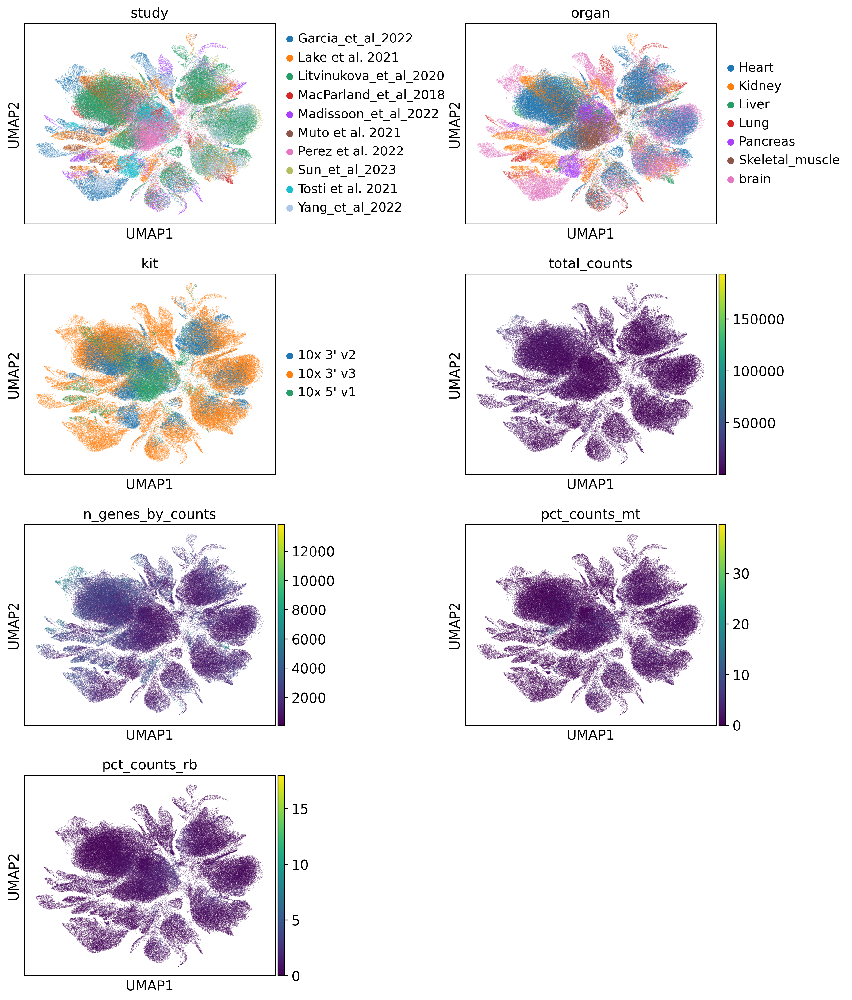

In [16]:
sc.settings.set_figure_params(dpi=150, facecolor='white')
sc.pl.umap(adata, color = ['study', 'organ',  'kit', 'total_counts', 'n_genes_by_counts','pct_counts_mt', 'pct_counts_rb'], wspace = 0.6, ncols = 2)

/opt/conda/envs/scvi/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/opt/conda/envs/scvi/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/opt/conda/envs/scvi/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


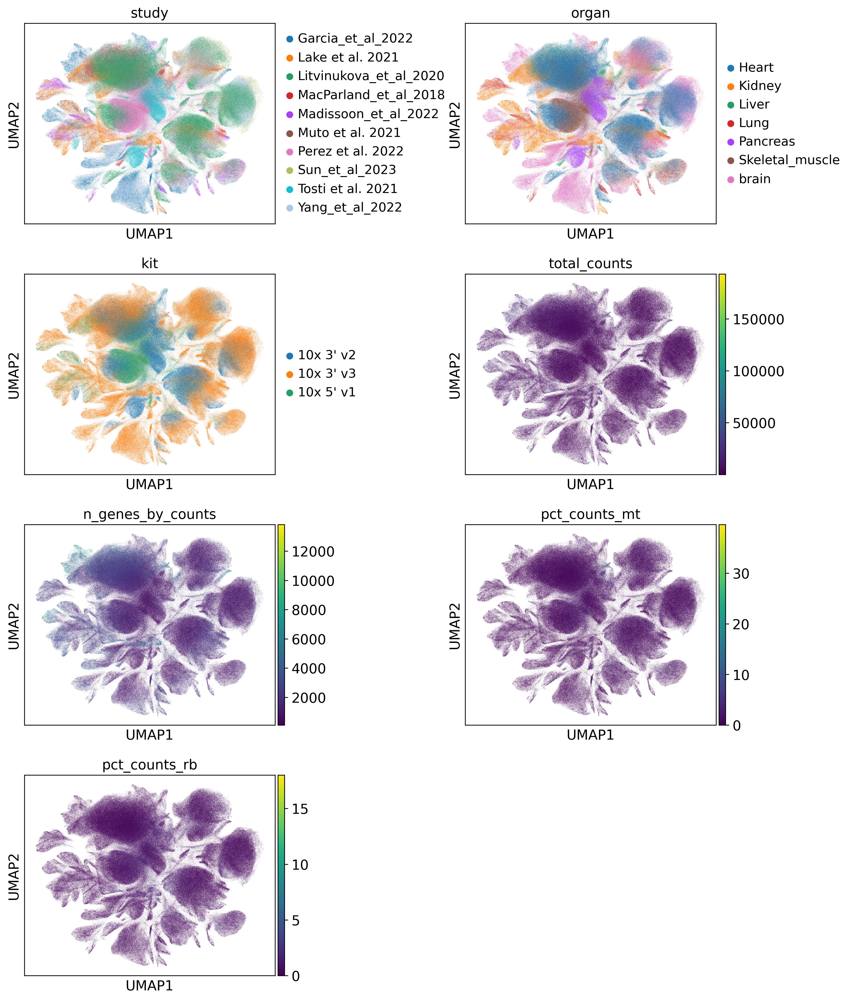

In [ ]:
sc.settings.set_figure_params(dpi=150, facecolor='white')
sc.pl.umap(adata, color = ['study', 'organ',  'kit', 'total_counts', 'n_genes_by_counts','pct_counts_mt', 'pct_counts_rb'], wspace = 0.6, ncols = 2)

In [17]:
adata

AnnData object with n_obs × n_vars = 976044 × 5000
    obs: 'subject', 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'id', 'library_id', 'batch', 'brain_region', 'age_death', 'msex', 'pmi', 'ADdiag2types', 'percent.mt', 'percent.rp', 'celltype', 'cellsubtype', 'donor', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_rb', 'pct_counts_rb', 'kit', 'study', 'organ', 'cell_or_nuclei', 'ID', 'Study', 'PoolDon', 'DonorPool', 'scDonor_snBatch', 'lung_cell_states', 'cell_state', 'lung_region', 'sample', 'sex', 'suspension_type', 'SampleID', 'PatientID', 'snRNAPreparation', 'RNA_snn_res.0.5', 'seurat_clusters', 'oricluster', 'newcluster', 'Dataset', 'development_stage', 'pancreas_cell_states', 'cell_type', 'skeletal_muscle_cell_states', 'suspension_uuid', 'liver_cell_states', 'liver_region', 'age_group', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'scrublet_score', 'heart_cell_states', 'heart_region', 'Cell', 'Treat', 'Sample', 'Region', 'nCount_SC

In [18]:
sc.tl.leiden(adata, resolution = 1, key_added='leiden_1')

running Leiden clustering
    finished: found 53 clusters and added
    'leiden_1', the cluster labels (adata.obs, categorical) (0:35:05)


In [19]:
adata.write('/home/jupyter/tmpmount/vasculature/nuclei/nuclei_datasets/whole_nuclei_objects/all_org_nuclei_log1p_scvi_lat3.h5ad')